In [14]:
import importlib
import os
import logging
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd

from params import Params
import params
importlib.reload(params)

#logging.basicConfig(encoding='utf-8', level=logging.DEBUG)
import embeddings_base
importlib.reload(embeddings_base)

import rwkv_runner
importlib.reload(rwkv_runner)
from rwkv_runner import rwkv
importlib.reload(rwkv_runner)
from source_file_iterator import SourceFileIterator
import source_file_iterator
importlib.reload(source_file_iterator)

modelname = 'RWKV-4-Raven-3B-v11-Eng49%-Chn49%-Jpn1%-Other1%-20230429-ctx4096.pth'

os.environ["RWKV_CUDA_ON"] = '1'
r = rwkv(modelname,
         '20B_tokenizer.json',
         model_load=False)

embeddings_base_logger= <Logger embeddings_base (INFO)>
<class 'tokenizers.Tokenizer'>
tokenizer class= <class 'tokenizers.Tokenizer'>
key_prefix= rwkv:RWKV-4-Raven-3B-v11-Eng49%-Chn49%-Jpn1%-Other1%-20230429-ctx4096.pth:Tokenizer


In [48]:
iter = SourceFileIterator(r.data_top_dir, r.data_subdirs, r.numTokensList)
dfs = []
for out in iter:
    file = out[0][1]
    numTokens = out[1][1]
    with open(file, "rb") as f:
        emb = r.getSlidingWindowEmbeddings(f, numTokens)
    df = pd.DataFrame(emb)
    dfs.append(df)
    #df['size']=0.01
dfs

[              0         1         2
 0      0.147339 -0.195312  0.265137
 1     -0.072510 -0.188354  0.136230
 2      0.512695 -0.453613  0.084167
 3     -0.509766 -0.060150 -0.245972
 4      0.721191  0.159912  0.498291
 ...         ...       ...       ...
 12763  0.134644 -0.206909 -0.064758
 12764  0.080444  0.033051  0.428711
 12765  0.106384  0.619141 -0.342529
 12766  1.155273 -0.096985  0.041748
 12767 -0.022766  0.362305  0.082397
 
 [12768 rows x 3 columns],
               0         1         2
 0      0.192749 -0.052277 -0.186768
 1      0.295654  0.196411 -0.235840
 2      0.495850 -0.038788  0.218018
 3     -0.020645 -0.153198  0.401367
 4      0.349365  0.253174 -0.062469
 ...         ...       ...       ...
 12763  0.133789 -0.068787  0.117249
 12764  0.366211 -0.016495 -0.139771
 12765 -0.058929  0.103821 -0.115662
 12766  2.253906  0.097473 -0.086609
 12767 -0.172607  0.128540  0.076599
 
 [12768 rows x 3 columns],
               0         1         2
 0      0.316650 

In [49]:
dfs[0]

,0,1,2
0,0.147339,-0.195312,0.265137
1,-0.072510,-0.188354,0.136230
2,0.512695,-0.453613,0.084167
3,-0.509766,-0.060150,-0.245972
4,0.721191,0.159912,0.498291
...,...,...,...
12763,0.134644,-0.206909,-0.064758
12764,0.080444,0.033051,0.428711
12765,0.106384,0.619141,-0.342529
12766,1.155273,-0.096985,0.041748


In [30]:
df.describe()

,0,1,2
count,12768.000000,12768.000000,12768.000000
mean,1.539896,1.539916,1.539955
std,31.015182,31.015181,31.015179
min,-1057.639893,-1057.639893,-1057.639893
25%,-0.137360,-0.136993,-0.136963
50%,0.227783,0.227783,0.227478
75%,3.659153,3.659153,3.659153
max,1110.788208,1110.788208,1110.788208


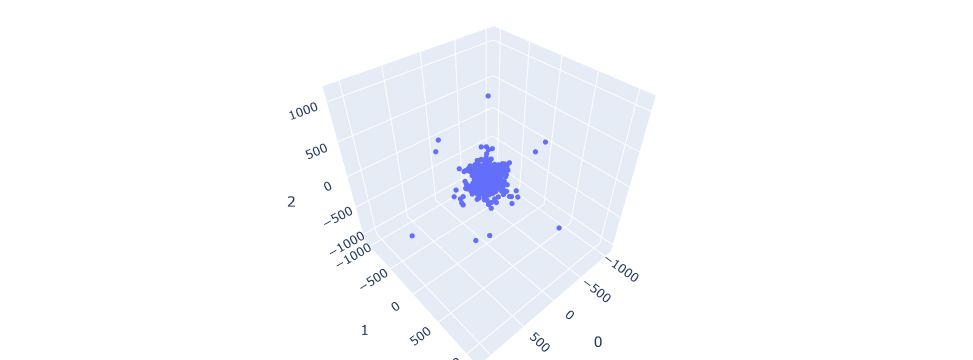

In [50]:
fig = px.scatter_3d(dfs[0], x=0, y=1, z=2,
                
                   )
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.update_traces(marker_size=2)
fig.show()

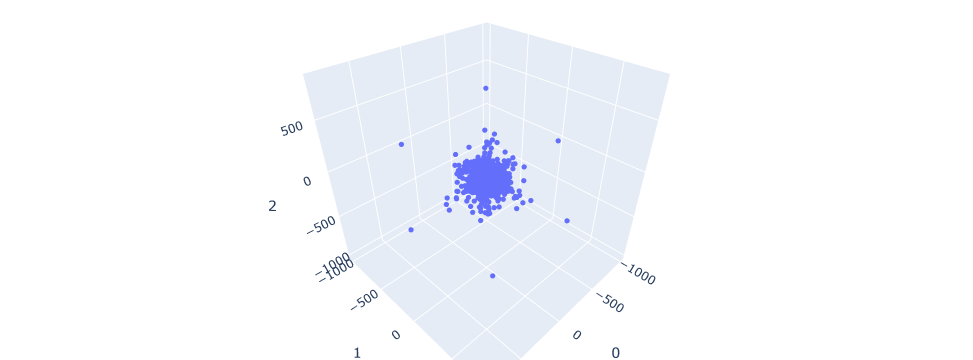

In [53]:
fig = px.scatter_3d(dfs[1], x=0, y=1, z=2,
                
                   )
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.update_traces(marker_size=2)
fig.show()

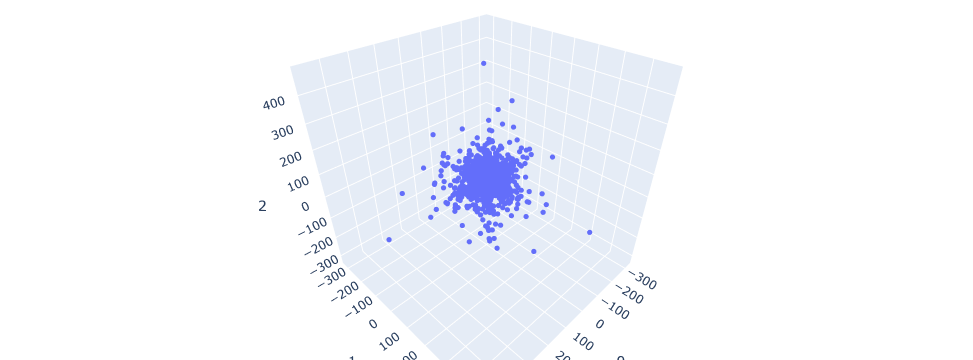

In [55]:
fig = px.scatter_3d(dfs[5], x=0, y=1, z=2,
                
                   )
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.update_traces(marker_size=2)
fig.show()

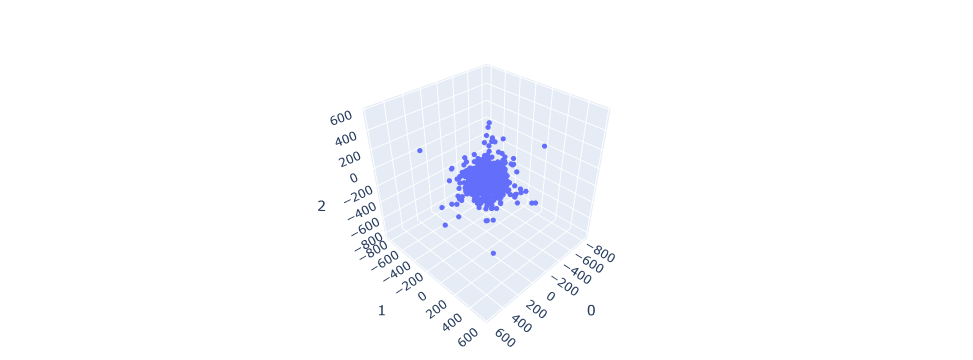

In [56]:
fig = px.scatter_3d(dfs[6], x=0, y=1, z=2,
                
                   )
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.update_traces(marker_size=2)
fig.show()

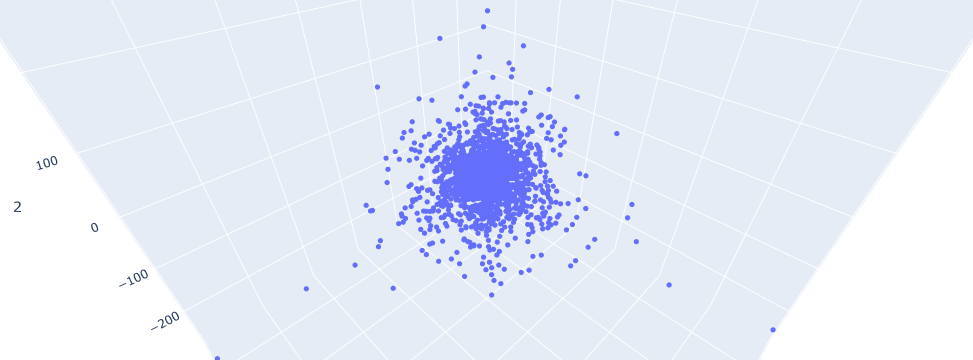

In [54]:
fig = px.scatter_3d(dfs[10], x=0, y=1, z=2,
                
                   )
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.update_traces(marker_size=2)
fig.show()

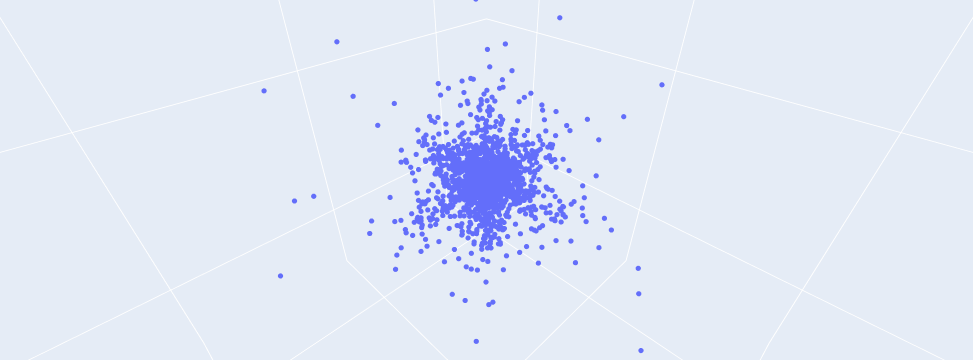

In [57]:
fig = px.scatter_3d(dfs[11], x=0, y=1, z=2,
                
                   )
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.update_traces(marker_size=2)
fig.show()

In [24]:
df

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1
...,...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica,3
146,6.3,2.5,5.0,1.9,virginica,3
147,6.5,3.0,5.2,2.0,virginica,3
148,6.2,3.4,5.4,2.3,virginica,3


### Sliding WindowからPDも求めるか

In [58]:
dfs[0]

,0,1,2
0,0.147339,-0.195312,0.265137
1,-0.072510,-0.188354,0.136230
2,0.512695,-0.453613,0.084167
3,-0.509766,-0.060150,-0.245972
4,0.721191,0.159912,0.498291
...,...,...,...
12763,0.134644,-0.206909,-0.064758
12764,0.080444,0.033051,0.428711
12765,0.106384,0.619141,-0.342529
12766,1.155273,-0.096985,0.041748


In [70]:
iter = SourceFileIterator(r.data_top_dir, r.data_subdirs, r.numTokensList)
dfs = []
for out in iter:
    file = out[0][1]
    numTokens = out[1][1]
    with open(file, "rb") as f:
        emb = r.getPersistenceDiagramEmbeddings(f, numTokens)
    df = pd.DataFrame(emb)
    dfs.append(df)
    #df['size']=0.01
dfs[0]

,0,1,2,3,4,5,6,7,8,9,...,34320,34321,34322,34323,34324,34325,34326,34327,34328,34329
0,0.000004,0.000004,0.000005,0.000006,0.000006,0.000006,0.000007,0.000006,0.000012,0.000011,...,8041.748668,8215.033178,8129.538854,9333.576441,7722.641003,11549.568052,12435.774493,102172.379535,104654.442219,106156.280928
1,0.000004,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000008,0.000012,0.000013,...,8049.182543,8215.225161,8387.514018,9335.829183,10627.261093,11994.184503,12457.811105,102278.875738,105543.211802,106720.234804


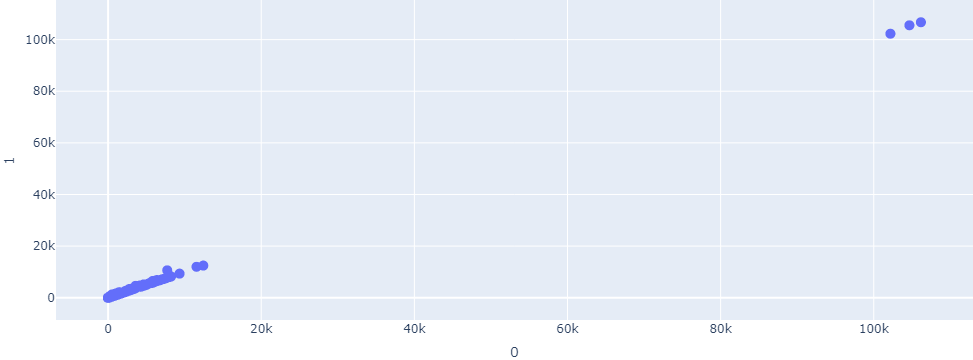

In [74]:
fig = px.scatter(dfs[0].T, x=0, y=1, 
                
                   )

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0), width=400)
fig.update_traces(marker_size=10)
#fig.update_xaxes(range=[-12,12],  scaleratio=1,)
#fig.update_yaxes(range=[-12,12],  scaleratio=1,)
fig.show()

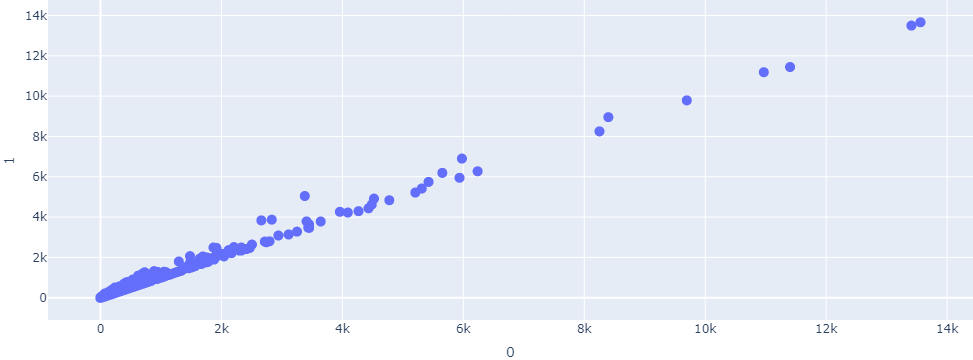

In [75]:
fig = px.scatter(dfs[5].T, x=0, y=1, 
                
                   )

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0), width=400)
fig.update_traces(marker_size=10)
#fig.update_xaxes(range=[-12,12],  scaleratio=1,)
#fig.update_yaxes(range=[-12,12],  scaleratio=1,)
fig.show()

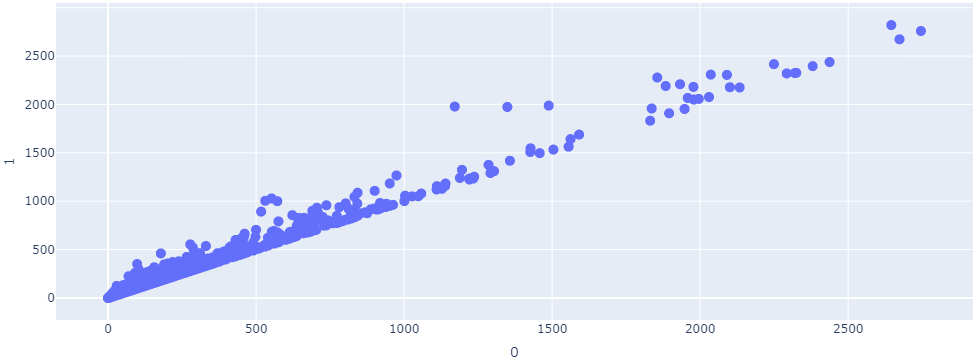

In [76]:
fig = px.scatter(dfs[10].T, x=0, y=1, 
                
                   )

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0), width=400)
fig.update_traces(marker_size=10)
#fig.update_xaxes(range=[-12,12],  scaleratio=1,)
#fig.update_yaxes(range=[-12,12],  scaleratio=1,)
fig.show()

In [67]:
dfs[0]

,0,1,2,3,4,5,6,7,8,9,...,34320,34321,34322,34323,34324,34325,34326,34327,34328,34329
0,0.000004,0.000004,0.000005,0.000006,0.000006,0.000006,0.000007,0.000006,0.000012,0.000011,...,8041.748668,8215.033178,8129.538854,9333.576441,7722.641003,11549.568052,12435.774493,102172.379535,104654.442219,106156.280928
1,0.000004,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000008,0.000012,0.000013,...,8049.182543,8215.225161,8387.514018,9335.829183,10627.261093,11994.184503,12457.811105,102278.875738,105543.211802,106720.234804


In [77]:
dfs[0]

,0,1,2,3,4,5,6,7,8,9,...,34320,34321,34322,34323,34324,34325,34326,34327,34328,34329
0,0.000004,0.000004,0.000005,0.000006,0.000006,0.000006,0.000007,0.000006,0.000012,0.000011,...,8041.748668,8215.033178,8129.538854,9333.576441,7722.641003,11549.568052,12435.774493,102172.379535,104654.442219,106156.280928
1,0.000004,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000008,0.000012,0.000013,...,8049.182543,8215.225161,8387.514018,9335.829183,10627.261093,11994.184503,12457.811105,102278.875738,105543.211802,106720.234804


In [81]:
import numpy as np
np.array(dfs[0]).reshape(1, -1)

array([[3.72394278e-06, 3.71516533e-06, 5.13817625e-06, ...,
        1.02278876e+05, 1.05543212e+05, 1.06720235e+05]])